# Zonal Statistics with HOLC

https://automating-gis-processes.github.io/CSC18/lessons/L6/zonal-statistics.html

In [14]:
# Import libraries

# System

import os

# Analysis

import numpy as np # Numerical Analysis
import pandas as pd # Data Mgmt
import geopandas as gpd # Spatial Data Mgmt
import rasterio # Rasters
from rasterio.transform import Affine
from rasterstats import zonal_stats

# Visualization

import matplotlib.pyplot as plt # Basic Plotting
plt.style.use('ggplot') # 
import seaborn as sns # Statistical Plotting
import contextily # Base Map Visualizationimport

In [2]:
# Load raster template

raster_path = os.path.join(os.getcwd(), '..', '2_Model_Pollutant_Exposure', 'template.npy')

raster = np.load(raster_path)

# metadata
rst = rasterio.open('../2_Model_Pollutant_Exposure/template.tif') # Open template
meta = rst.meta.copy() # Copy template metadata
# meta.update(compress='lzw') # Good for integers/categorical rasters
rst.close()

# Minneapolis Boundary

mpls_path = os.path.join(os.getcwd(), '..', '1_Data_IO', 'Data', 'mpls_boundary.geojson')
mpls = gpd.read_file(mpls_path)

In [3]:
# Load Zones (HOLC)

path_to_zones = os.path.join(os.getcwd(), '..', '1_Data_IO', 'Data', 'holc.geojson')

holc = gpd.read_file(path_to_zones)

In [4]:
# Load indices

# Filenames

path_to_indices = os.path.join(os.getcwd(), '..', '3_Environmental_Hazard_Cost_Surface', 'Tests')

filenames = os.listdir(path_to_indices)
layernames = []

index_paths = []

indices = {}

for filename in filenames:

    path = os.path.join(path_to_indices, filename)
    
    index_paths += [path]
    
    layername = filename.split('_')[0]
    
    rasterio_rast = rasterio.open(path)
    
    indices[layername] = rasterio_rast.read(1)
    
    rasterio_rast.close()

# It appears you have a bad affine transformation

https://stackoverflow.com/questions/62010050/from-zonal-stats-i-get-this-error-valueerror-width-and-height-must-be-0

https://stackoverflow.com/questions/55307096/compute-zonal-statistics-for-a-numpy-array-in-rotated-coordinate-space#comment97451882_55307096

In [15]:
# Flip the raster
# From: https://github.com/perrygeo/python-rasterstats/issues/98

def flipud(raster, affine):
    raster = np.flipud(raster)
    affine = Affine(
        affine.a,
        affine.b,
        affine.c,
        affine.d,
        -1 * affine.e,
        affine.f + (affine.e * (raster.shape[0] - 1)),
    )
    return raster, affine

In [90]:
# Get zonal statistics

import warnings
warnings.filterwarnings('ignore')

zonal_stat_gdfs = {}

for index_name in indices:
    raster = indices[index_name]
    affine = meta['transform']
    
    new_rast, new_affine = flipud(raster, affine) # flip the raster
    
    zs = zonal_stats(path_to_zones, new_rast, affine = new_affine, geojson_out=True) # Get zonal stats
    
    zonal_stat_gdfs[index_name] = gpd.GeoDataFrame.from_features(zs, crs = 'EPSG:26915') # Save as geodataframe

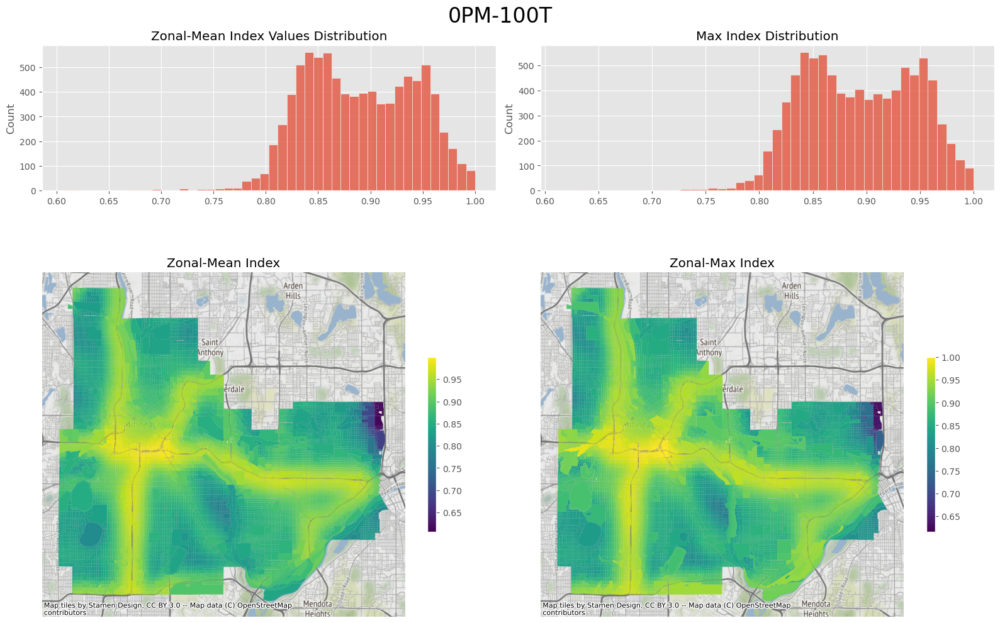

Min Index (Zonal Stat) =  0.5979369789145219
Max Index (Zonal Stat) =  1.0
Average Index (From Raster) =  0.8146761744214887
Average Index (Zonal Stat) =  0.8893080571925124
Average Hazardous Region Index =  0.9179742652866497


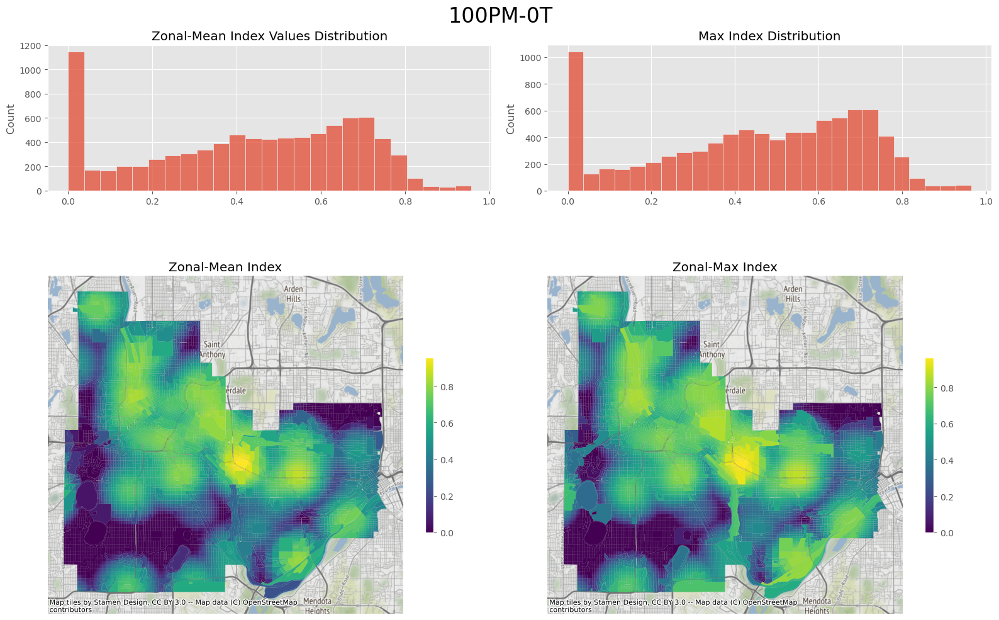

Min Index (Zonal Stat) =  0.0
Max Index (Zonal Stat) =  0.9651240566347867
Average Index (From Raster) =  0.3742836034708651
Average Index (Zonal Stat) =  0.43029207066788583
Average Hazardous Region Index =  0.5683578942194256


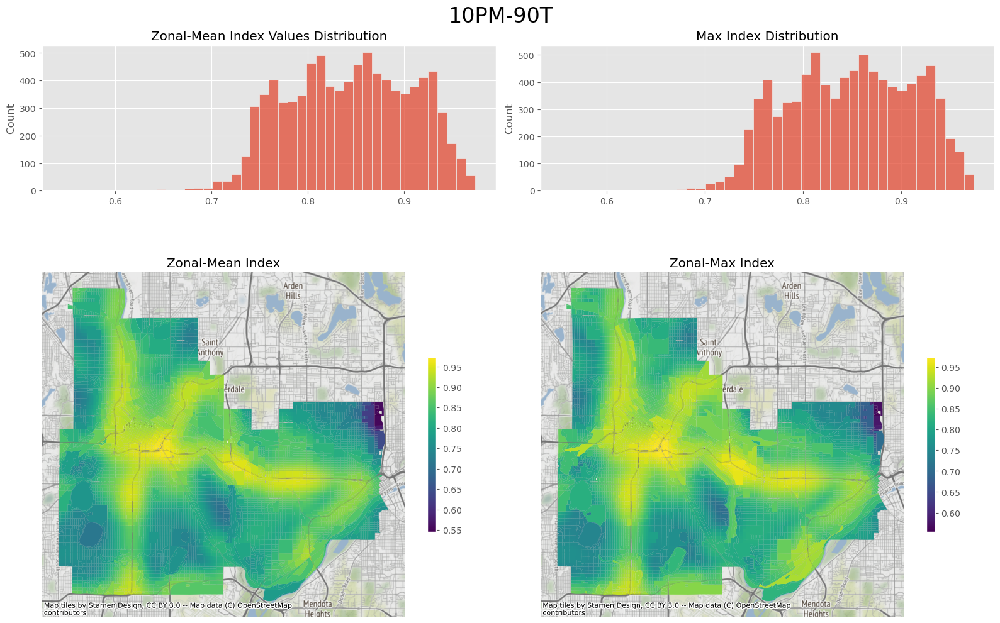

Min Index (Zonal Stat) =  0.5381432810230697
Max Index (Zonal Stat) =  0.9737681958317045
Average Index (From Raster) =  0.7706369173264266
Average Index (Zonal Stat) =  0.8434064585400497
Average Hazardous Region Index =  0.8830126281799271


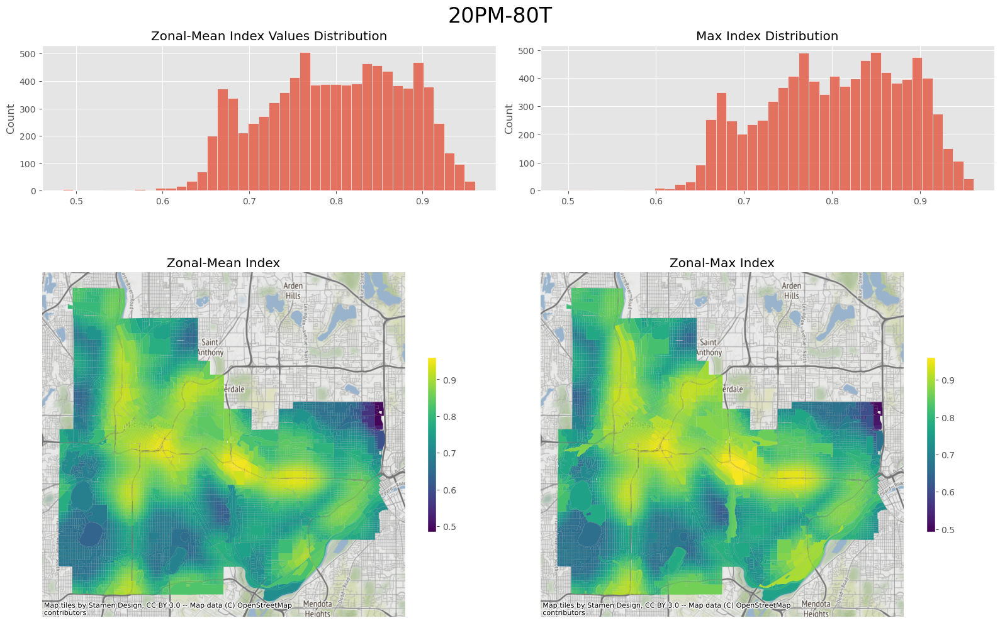

Min Index (Zonal Stat) =  0.4783495831316176
Max Index (Zonal Stat) =  0.9611637430495281
Average Index (From Raster) =  0.7265976602313641
Average Index (Zonal Stat) =  0.7975048598875872
Average Hazardous Region Index =  0.8480509910732049


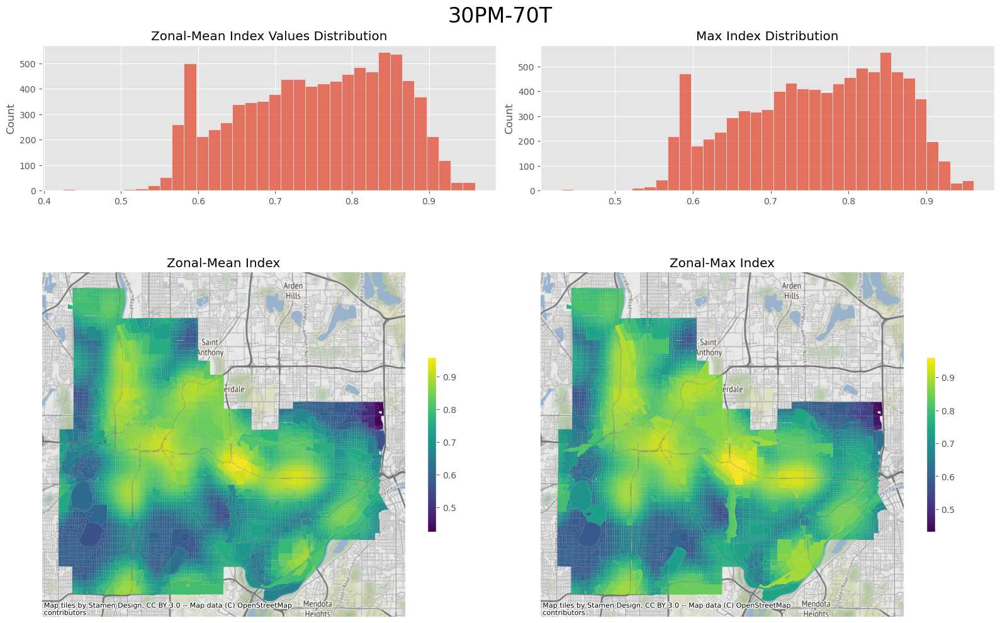

Min Index (Zonal Stat) =  0.4185558852401653
Max Index (Zonal Stat) =  0.9611502155929099
Average Index (From Raster) =  0.6825584031363017
Average Index (Zonal Stat) =  0.7516032612351244
Average Hazardous Region Index =  0.8130893539664824


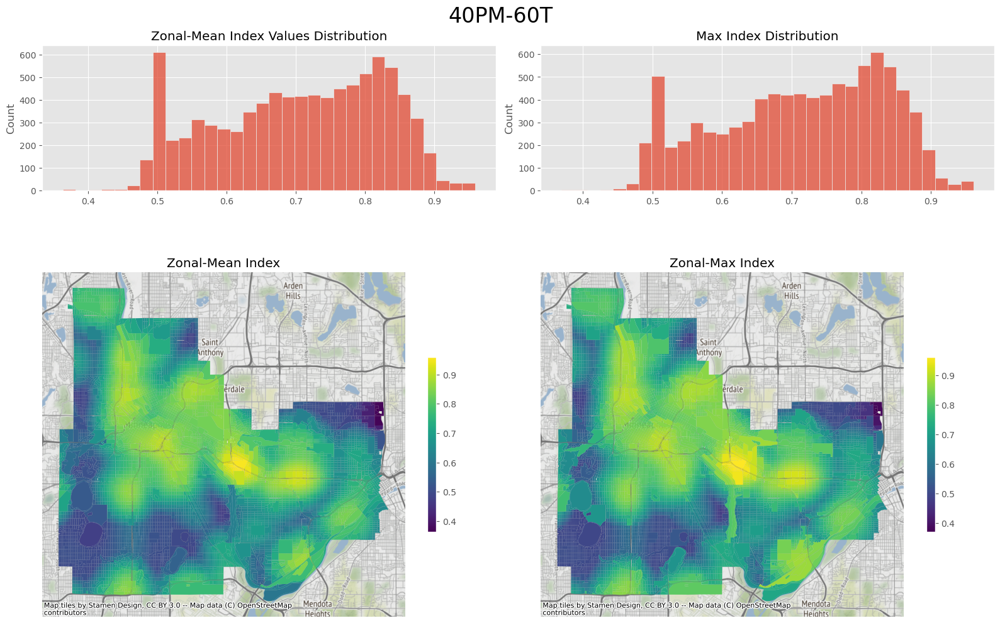

Min Index (Zonal Stat) =  0.3587621873487131
Max Index (Zonal Stat) =  0.9612529383856669
Average Index (From Raster) =  0.6385191460412393
Average Index (Zonal Stat) =  0.7057016625826619
Average Hazardous Region Index =  0.7781277168597599


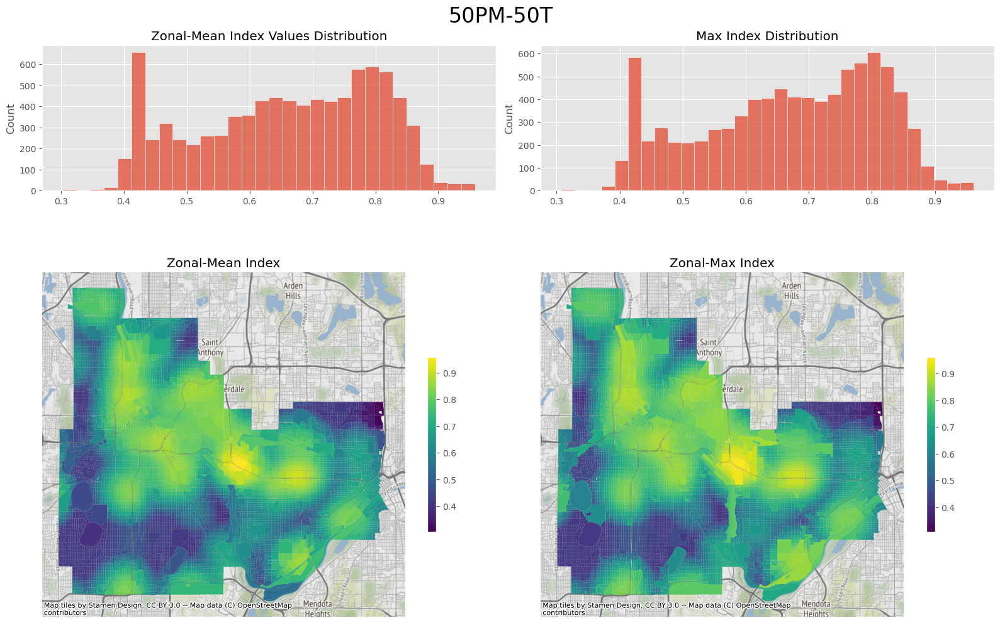

Min Index (Zonal Stat) =  0.29896848945726096
Max Index (Zonal Stat) =  0.9616035480648696
Average Index (From Raster) =  0.5944798889461769
Average Index (Zonal Stat) =  0.6598000639301992
Average Hazardous Region Index =  0.7431660797530376


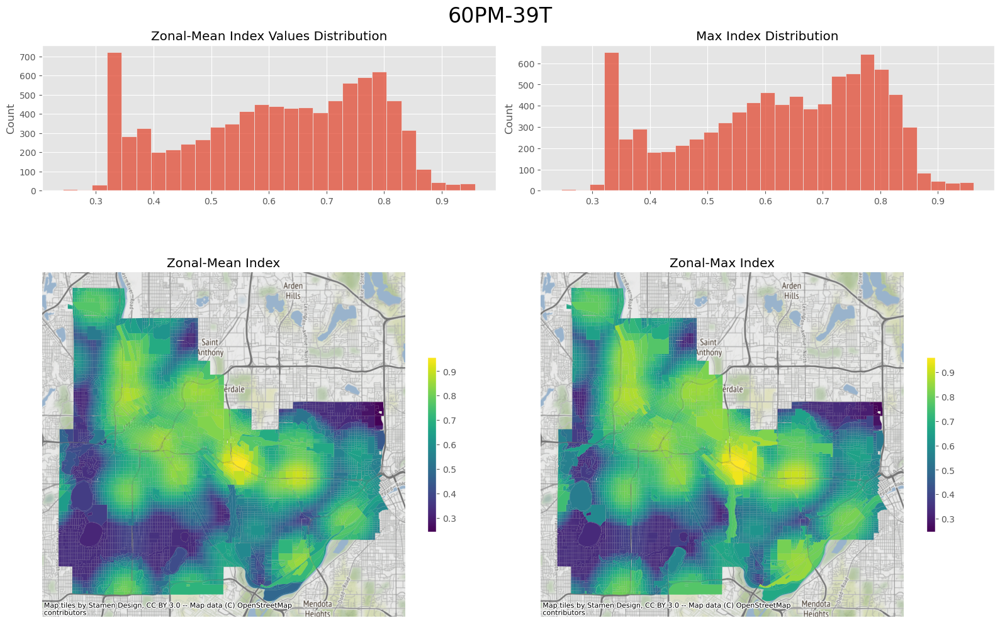

Min Index (Zonal Stat) =  0.2391747915658087
Max Index (Zonal Stat) =  0.9621339085114733
Average Index (From Raster) =  0.5504406318511144
Average Index (Zonal Stat) =  0.6138984652777365
Average Hazardous Region Index =  0.7082044426463152


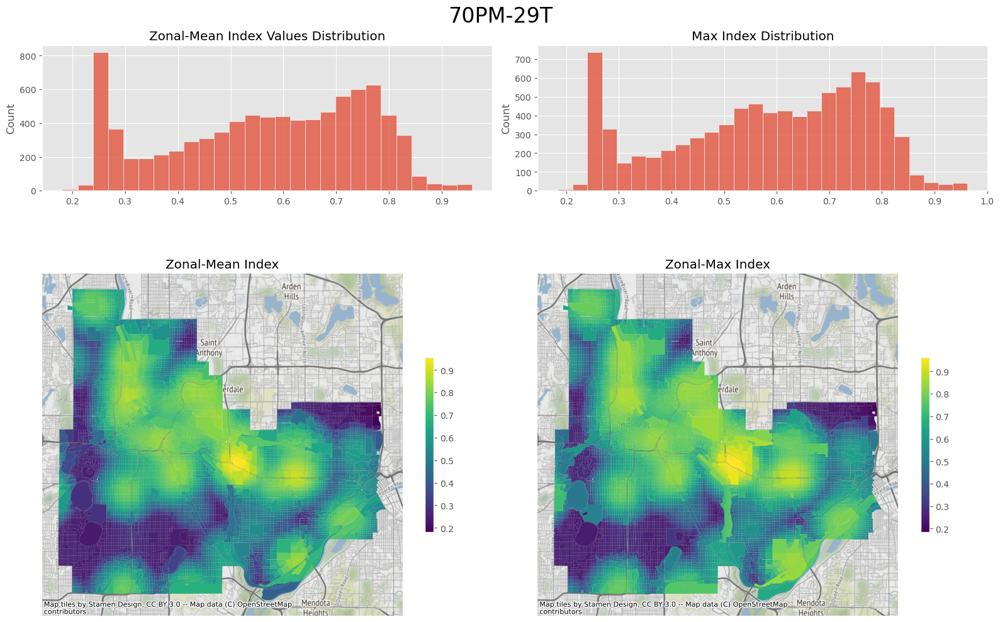

Min Index (Zonal Stat) =  0.17938109367435653
Max Index (Zonal Stat) =  0.9627070009461979
Average Index (From Raster) =  0.5064013747560521
Average Index (Zonal Stat) =  0.5679968666252738
Average Hazardous Region Index =  0.6732428055395928


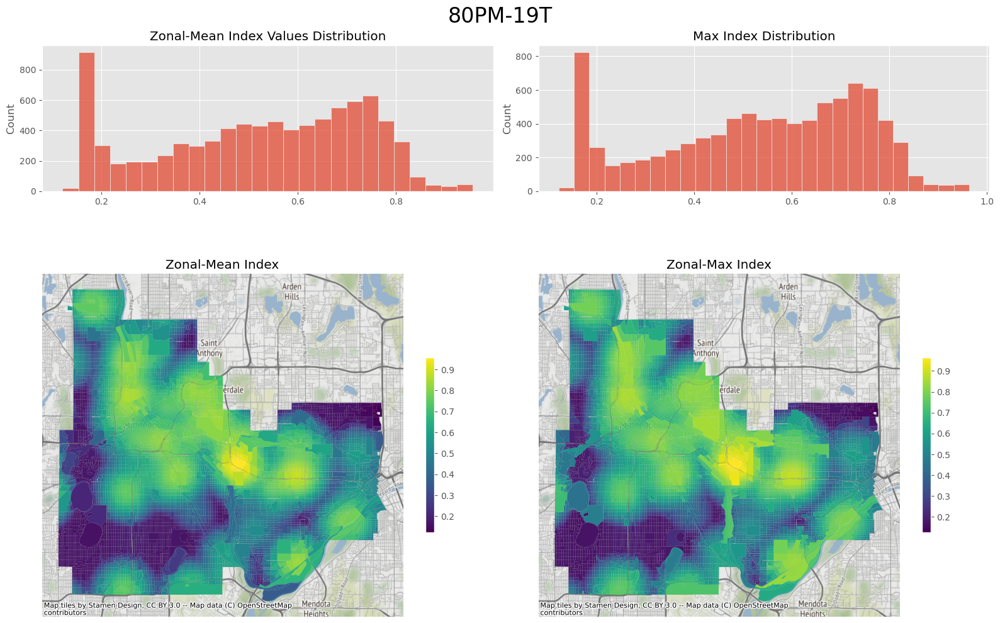

Min Index (Zonal Stat) =  0.11958739578290435
Max Index (Zonal Stat) =  0.9634611931332895
Average Index (From Raster) =  0.4623621176609899
Average Index (Zonal Stat) =  0.5220952679728111
Average Hazardous Region Index =  0.6382811684328704


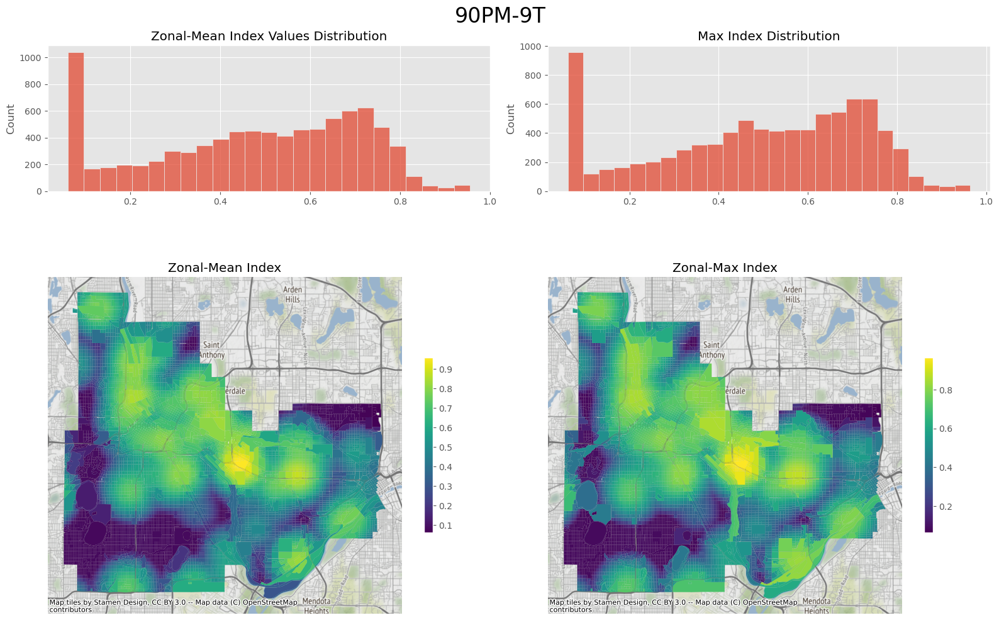

Min Index (Zonal Stat) =  0.059793697891452176
Max Index (Zonal Stat) =  0.9642343457235127
Average Index (From Raster) =  0.41832286056592716
Average Index (Zonal Stat) =  0.4761936693203485
Average Hazardous Region Index =  0.603319531326148


In [150]:
# Look at distributions (both values and spatially)
# of Zonal Average & Zonal Maximum

# What about sum <- doesn't really make sense because the zones have different areas 

# Sort index names for presentation order
sorted_index_names = list(zonal_stat_gdfs.keys())
sorted_index_names.sort()

for index_name in sorted_index_names:
    
    gdf = zonal_stat_gdfs[index_name] # Get Zonal Stats
    
    gdf = gdf.dropna() # Drop Nans
    
    means = gdf['mean'].values # Get zonalMean values
    maxs = gdf['max'].values # Get zonalMax values
    
    f, axs = plt.subplots(2,2, figsize = (16, 12), height_ratios=[1, 4]) # Initialize Plot (2rows, 2columns)
    
    f.suptitle(index_name, fontsize = 24)
    
    # Histogram of Zonal Mean
        
    sns.histplot(means, ax = axs[0,0])
    
    axs[0,0].set_title('Zonal-Mean Index Values Distribution')
    
    # Histogram of Zonal Max
    
    sns.histplot(maxs, ax = axs[0,1])
    
    axs[0,1].set_title('Max Index Distribution')
                       
    # Zonal Mean choropleth
    
    gdf.plot(column = 'mean', legend = True, ax = axs[1,0], legend_kwds={'shrink': 0.3})
    
    axs[1,0].set_title('Zonal-Mean Index')
    axs[1,0].set_axis_off()
    
    contextily.add_basemap(ax = axs[1,0],
                       crs = gdf.crs)
    
    # Zonal Max choropleth
    
    gdf.plot(column = 'max', legend = True, ax = axs[1,1], legend_kwds={'shrink': 0.3})
    
    axs[1,1].set_title('Zonal-Max Index')
    axs[1,1].set_axis_off()
    contextily.add_basemap(ax = axs[1,1],
                       crs = gdf.crs)
    
    f.tight_layout()
    figpath = os.path.join('Visualizations', index_name + '_ZonalStatsDistribution')
    f.savefig(figpath)
    plt.show()
    
    # General Stats
    
    print('Min Index (Zonal Stat) = ', gdf['min'].min())
    print('Max Index (Zonal Stat) = ', gdf['max'].max())
    print('Average Index (From Raster) = ', np.mean(indices[index_name]))
    print('Average Index (Zonal Stat) = ', gdf['mean'].mean())
    print('Average Hazardous Region Index = ', 
          gdf[gdf['HSG_SCALE'] == 'Hazardous']['mean'].mean())

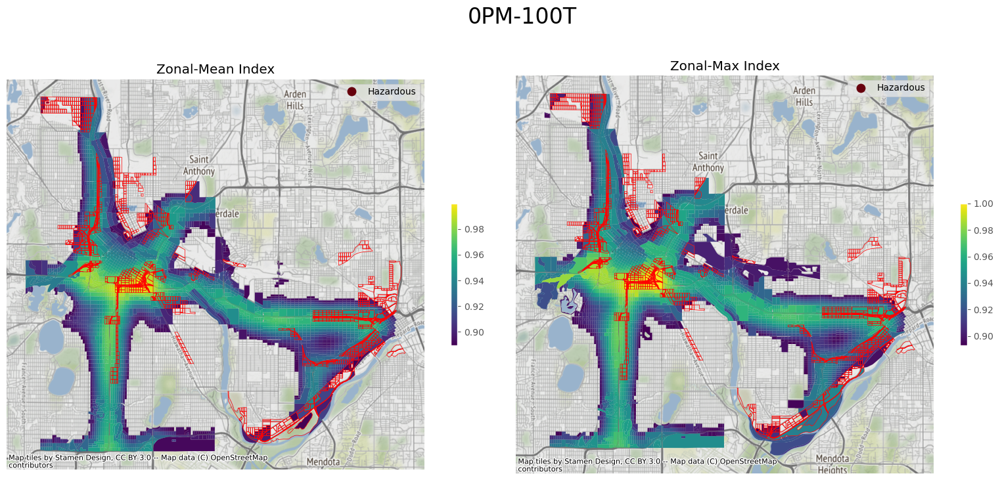

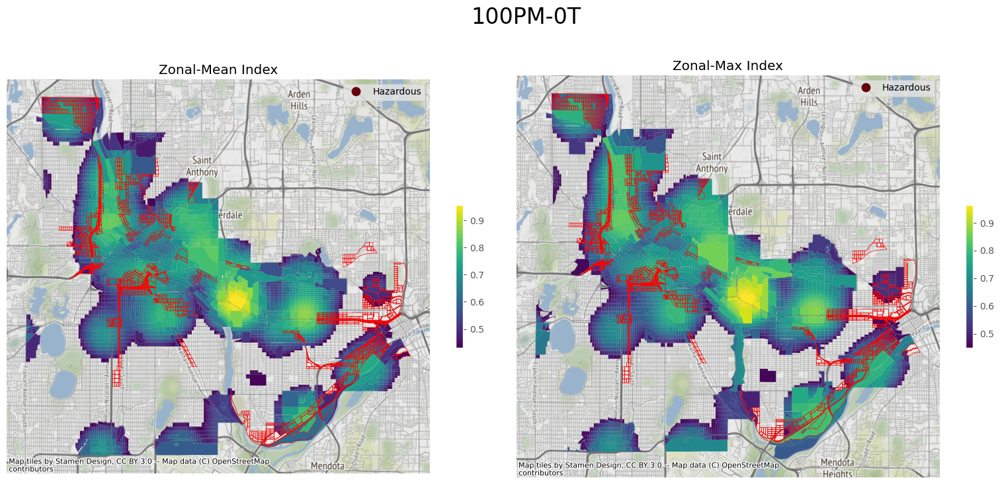

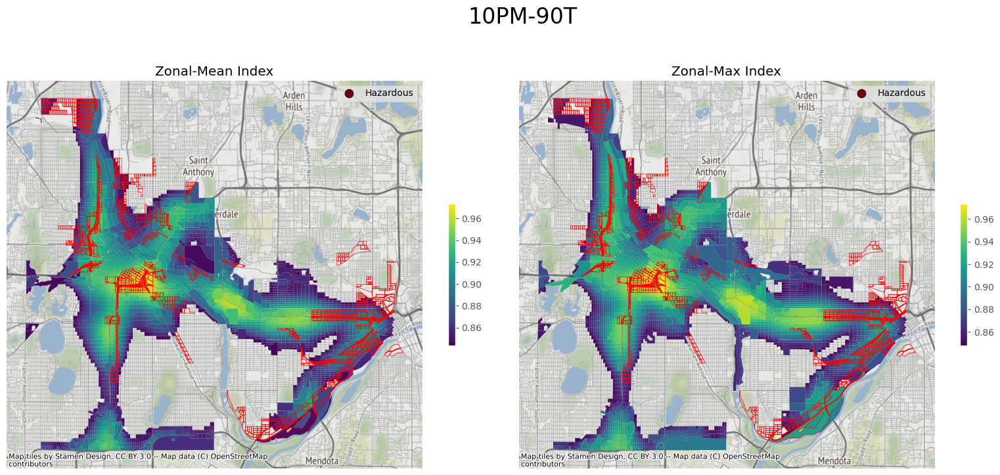

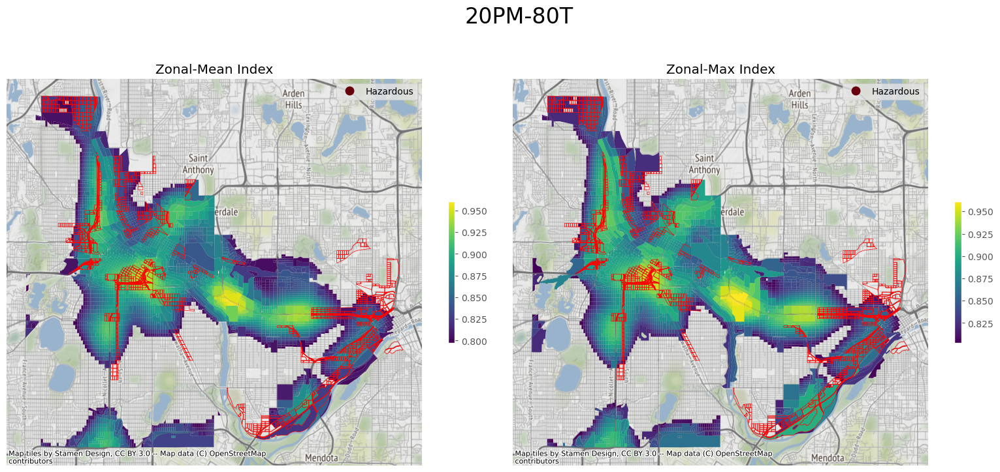

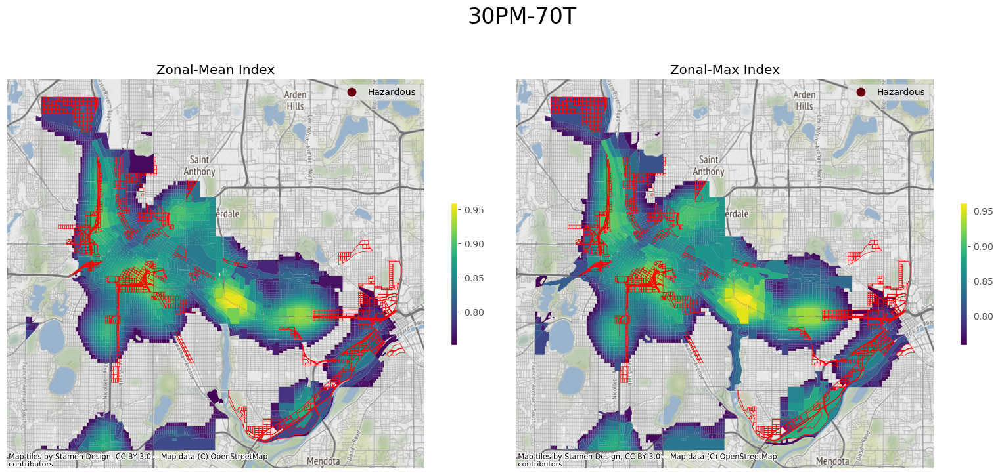

...

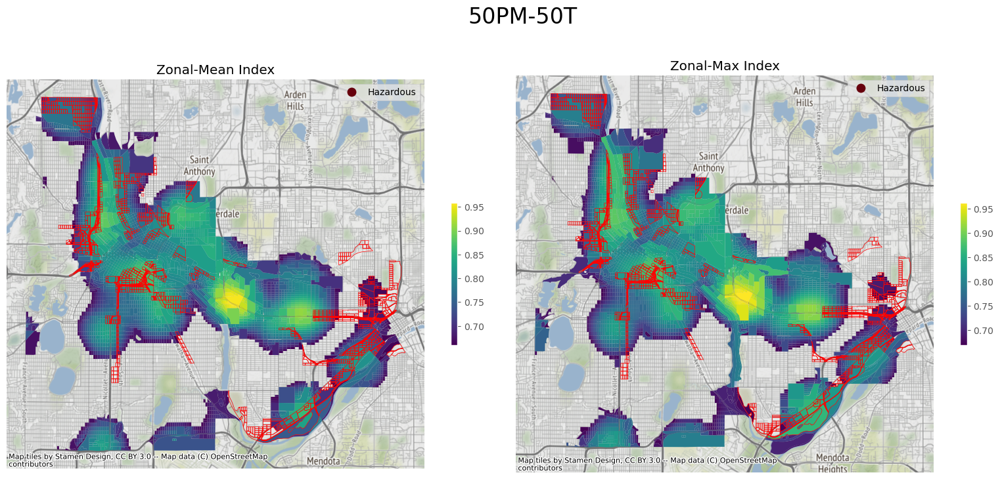

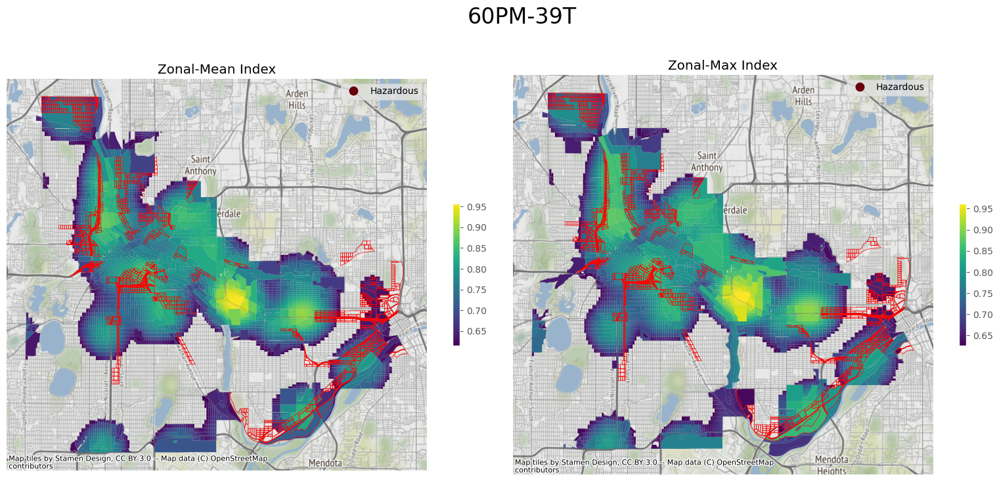

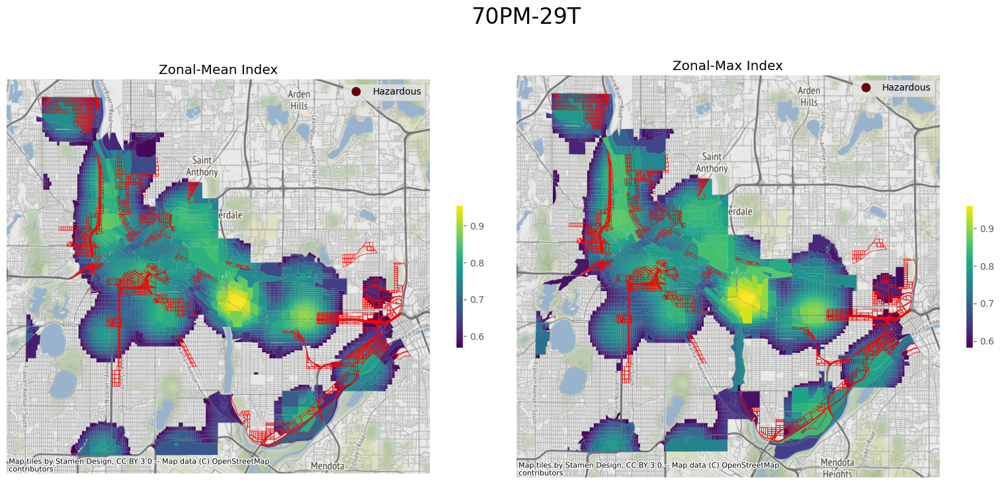

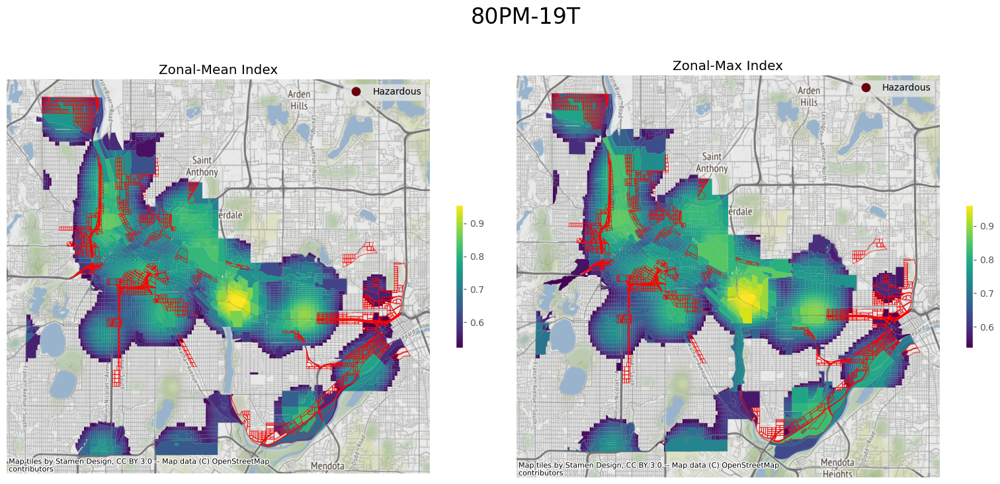

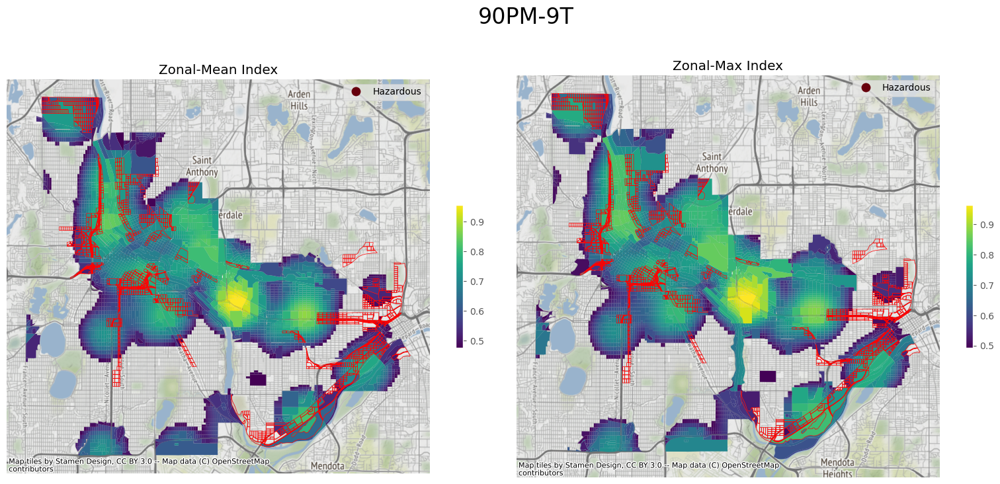

In [151]:
# Only show those above some threshold (average?)

for index_name in sorted_index_names:
    
    gdf = zonal_stat_gdfs[index_name] # Get Zonal Stats
    
    gdf = gdf.dropna() # Drop Nans
    
    means = gdf['mean'].values # Get zonalMean values
    maxs = gdf['max'].values # Get zonalMax values
    
    f, axs = plt.subplots(1,2, figsize = (16, 8))#, height_ratios=[1, 4]) # Initialize Plot (1rows, 2columns)
    
    f.suptitle(index_name, fontsize = 24)

    # Zonal Mean choropleth
    
    select = gdf[gdf['mean']>means.mean()] # Selecting those over the mean
    
    select.plot(column = 'mean', legend = True, ax = axs[0], legend_kwds={'shrink': 0.3})
       
    gdf[gdf['HSG_SCALE'] == 'Hazardous'].plot(column = 'HSG_SCALE', ax = axs[0],
                                             edgecolor='red', facecolor='none',
                                              cmap = 'Reds_r',
                                             zorder = 2,
                                             legend = True) # Outline "Hazardous" regions

    axs[0].set_title('Zonal-Mean Index')
    axs[0].set_axis_off()
    
    contextily.add_basemap(ax = axs[0],
                       crs = gdf.crs)
    
    # Zonal Max choropleth
    
    select = gdf[gdf['max']>maxs.mean()] # Selecting those over the mean
    
    select.plot(column = 'max', legend = True, ax = axs[1], legend_kwds={'shrink': 0.3})
    
    gdf[gdf['HSG_SCALE'] == 'Hazardous'].plot(column = 'HSG_SCALE', ax = axs[1],
                                             edgecolor='red', facecolor='none',
                                              cmap = 'Reds_r',
                                             zorder = 2,
                                             legend = True) # Outline "Hazardous" regions
    
    axs[1].set_title('Zonal-Max Index')
    axs[1].set_axis_off()
    contextily.add_basemap(ax = axs[1],
                       crs = gdf.crs)
    f.tight_layout()
    figpath = os.path.join('Visualizations', index_name + '_HighZonalStats&HazardousZones')
    f.savefig(figpath)
    plt.show()